<a href="https://colab.research.google.com/github/sharmila2704/ML/blob/main/Brain_tumor_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name -** Brain Tumor MRI Image Classification


# **Project Type -** EDA and Classification

# **Project Summary -**
The Brain Tumor MRI Image Classification project aims to develop a deep learning-based solution that classifies brain MRI images into multiple tumor types. The project involves building a custom Convolutional Neural Network (CNN) model and leveraging Transfer Learning with pretrained models like ResNet50, MobileNetV2, InceptionV3, and EfficientNetB0 to improve accuracy and generalization.

The workflow includes data preprocessing, augmentation, model building, evaluation, and comparison. Real-time predictions are enabled through a Streamlit-based web application, allowing users to upload MRI scans and receive tumor classification along with confidence scores.

This solution supports AI-assisted diagnostics, early detection, clinical research, and telemedicine, making it highly applicable in healthcare environments, especially in under-resourced areas.



# **GitHub Link -**

# **Problem Statement -**
This project aims to develop a deep learning-based solution for classifying brain MRI images into multiple categories according to tumor type. It involves building a custom CNN model from scratch and enhancing performance through transfer learning using pretrained models. The project also includes deploying a user-friendly Streamlit web application to enable real-time tumor type predictions from uploaded MRI images.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import numpy as np
import cv2
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Dropout, concatenate, Dense, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt


In [ ]:
import zipfile
import os

# Path to the ZIP file (modify if filename is slightly different)
zip_path = '/content/drive/MyDrive/Tumour-20250713T075424Z-1-001.zip'

# Destination folder to unzip into
extract_path = '/content/tumor_data'

# Unzip it
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print("Unzipped files:")
print(os.listdir(extract_path))



Unzipped files:
['Tumour']


In [ ]:
for item in os.listdir(extract_path):
    print(item)


Tumour


In [ ]:
import os

for root, dirs, files in os.walk('/content/tumor_data'):
    level = root.replace('/content/tumor_data', '').count(os.sep)
    indent = ' ' * 4 * level
    print(f"{indent}{os.path.basename(root)}/")
    subindent = ' ' * 4 * (level + 1)
    for f in files[:5]:  # Show first 5 files per folder
        print(f"{subindent}{f}")


tumor_data/
    Tumour/
        README.dataset.txt
        test/
            _classes.csv
            glioma/
                Tr-gl_0369_jpg.rf.05a79e2e0107ee8135ed6bc1cc4bd901.jpg
                Tr-gl_0145_jpg.rf.d3c502513655260a6addaf252fcec4b7.jpg
                Tr-gl_0466_jpg.rf.5d94c0be6e42eb7b605239eff07747e3.jpg
                Tr-gl_0486_jpg.rf.e6b7a5aa7d3600d0ce2f1997e3ac5dd9.jpg
                Tr-gl_0381_jpg.rf.9389dcdc94c61b058b96aff07e6fecbb.jpg
            pituitary/
                Tr-pi_0537_jpg.rf.fe2f30dd6e2f1ea090da9679259a608e.jpg
                Tr-pi_0397_jpg.rf.661aa3bad2506a3ad381a611a9c5e9ba.jpg
                Tr-pi_0130_jpg.rf.15adee5c88949e10f62a9c54294adaf9.jpg
                Tr-pi_0376_jpg.rf.ecf3d775893487c3664bab31dfe41c6a.jpg
                Tr-pi_0519_jpg.rf.ee5ee202a402bb9e276d15b0afdcd365.jpg
            no_tumor/
                Tr-no_0017_jpg.rf.2cedc1f6703d5a0b33b09208957d9223.jpg
                Tr-no_0043_jpg.rf.5224aefedc2bd0860814754ea61bb6

In [ ]:
#  Dataset Paths
train_dir = '/content/tumor_data/Tumour/train'
val_dir = '/content/tumor_data/Tumour/valid'
test_dir = '/content/tumor_data/Tumour/test'
IMG_SIZE = (128, 128)

In [ ]:
#  Label Mapping Dictionary
label_mapping = {
    0: "Glioma Tumor",
    1: "Meningioma Tumor",
    2: "Pituitary Tumor",
    3: "No Tumor"
}


In [ ]:
#  Preprocessing Function
def load_data(data_dir, img_size=(128, 128)):
    images, masks, labels = [], [], []

    for category in os.listdir(data_dir):
        category_path = os.path.join(data_dir, category)
        if not os.path.isdir(category_path): # Add this check to skip files
            continue

        for img_name in os.listdir(category_path):
            img_path = os.path.join(category_path, img_name)

            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.resize(img, img_size) / 255.0
                images.append(img)

                gray = cv2.cvtColor((img * 255).astype(np.uint8), cv2.COLOR_BGR2GRAY)
                _, mask = cv2.threshold(gray, 120, 255, cv2.THRESH_BINARY)
                mask = mask / 255.0
                masks.append(np.expand_dims(mask, axis=-1))

                if "glioma" in category:
                    labels.append(0)
                elif "meningioma" in category:
                    labels.append(1)
                elif "pituitary" in category:
                    labels.append(2)
                else:
                    labels.append(3)
            else:
                print(f"Warning: Could not load image at {img_path}. Skipping...")

    return np.array(images), np.array(masks), np.array(labels)

In [ ]:
import os
import cv2
import numpy as np

def load_data(data_dir, img_size=(128, 128)):
    X = []
    Y = []
    labels = []
    class_names = os.listdir(data_dir)
    class_names.sort()  # to keep label consistency

    for label, class_name in enumerate(class_names):
        class_path = os.path.join(data_dir, class_name)
        if not os.path.isdir(class_path):
            continue  # Skip if not a directory
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)
            try:
                img = cv2.imread(img_path)
                img = cv2.resize(img, img_size)
                img = img / 255.0  # Normalize
                X.append(img)
                Y.append(label)
                labels.append(class_name) # Add label only if it's a directory
            except:
                continue

    return np.array(X), np.array(Y), np.array(labels)

In [ ]:
X_train, Y_train, labels_train = load_data(train_dir)
X_val, Y_val, labels_val = load_data(val_dir)
X_test, Y_test, labels_test = load_data(test_dir)

In [ ]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
Y_train_encoded = le.fit_transform(Y_train)
Y_val_encoded = le.transform(Y_val)
Y_test_encoded = le.transform(Y_test)

print("Label classes:", le.classes_)


Label classes: [1 2 3 4]


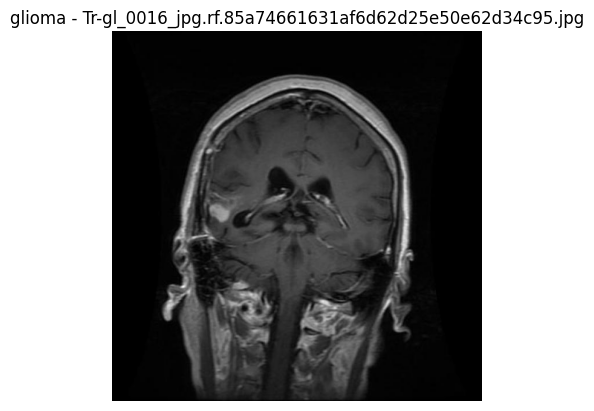

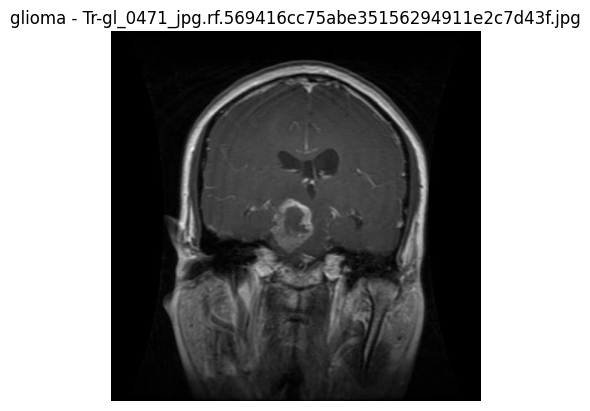

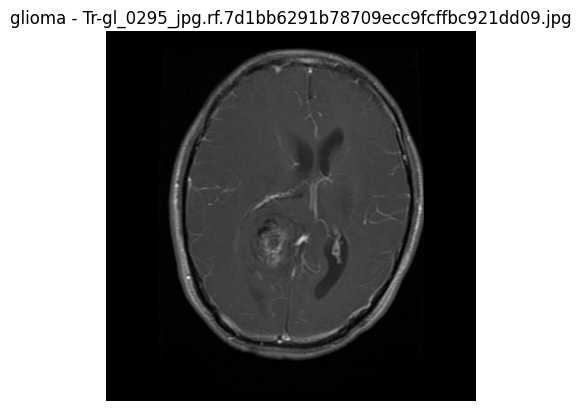

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

sample_image_path = os.path.join(train_dir, 'glioma')
image_files = os.listdir(sample_image_path)

# Show 3 sample images
for i in range(3):
    img_path = os.path.join(sample_image_path, image_files[i])
    img = mpimg.imread(img_path)
    plt.imshow(img)
    plt.title(f"glioma - {image_files[i]}")
    plt.axis('off')
    plt.show()


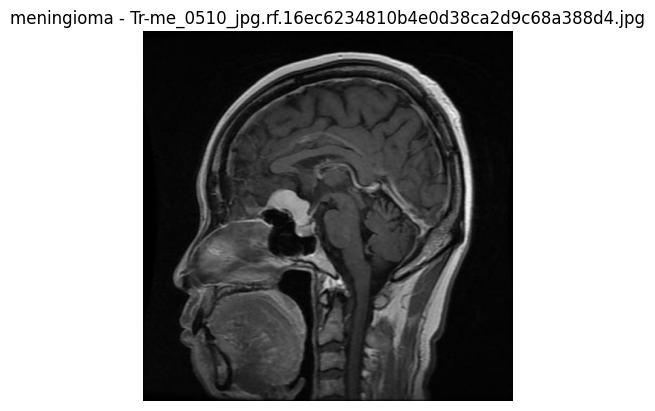

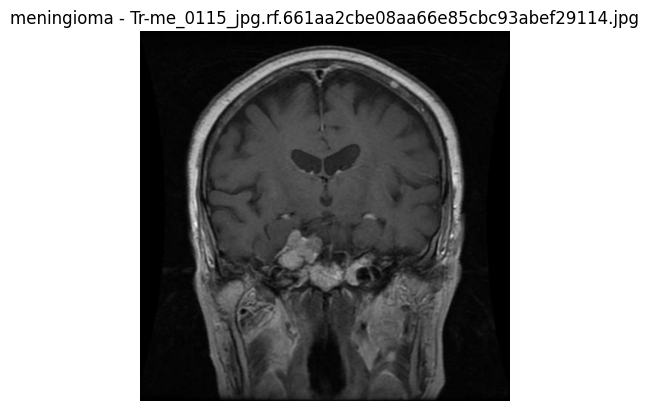

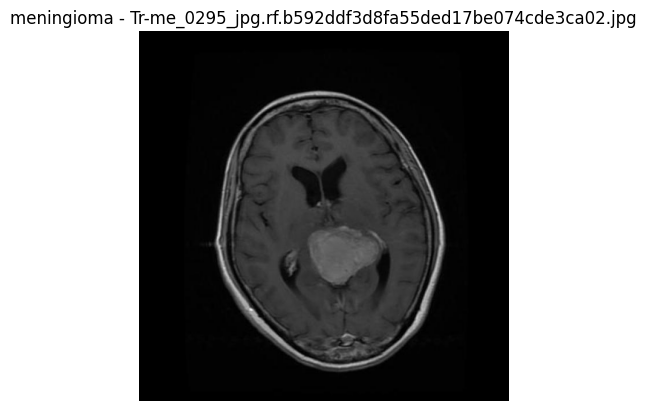

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

sample_image_path = os.path.join(train_dir, 'meningioma')
image_files = os.listdir(sample_image_path)

# Show 3 sample images
for i in range(3):
    img_path = os.path.join(sample_image_path, image_files[i])
    img = mpimg.imread(img_path)
    plt.imshow(img)
    plt.title(f"meningioma - {image_files[i]}")
    plt.axis('off')
    plt.show()

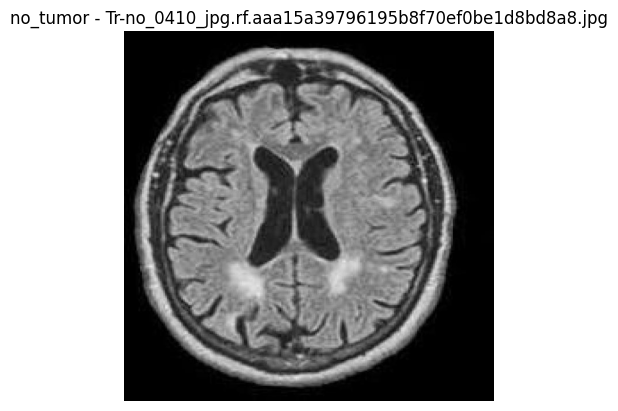

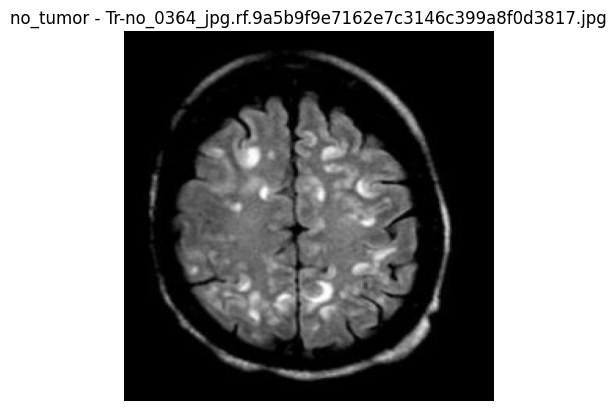

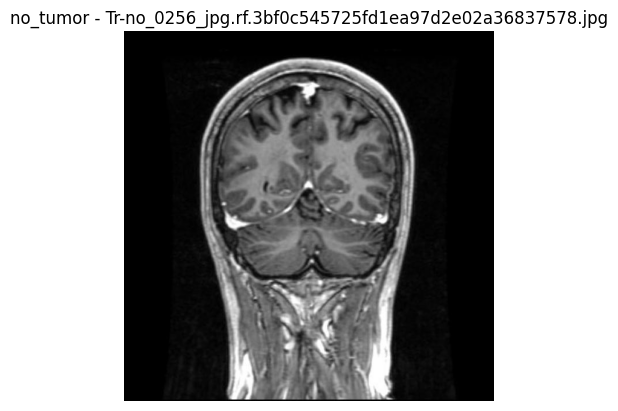

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

sample_image_path = os.path.join(train_dir, 'no_tumor')
image_files = os.listdir(sample_image_path)

# Show 3 sample images
for i in range(3):
    img_path = os.path.join(sample_image_path, image_files[i])
    img = mpimg.imread(img_path)
    plt.imshow(img)
    plt.title(f"no_tumor - {image_files[i]}")
    plt.axis('off')
    plt.show()

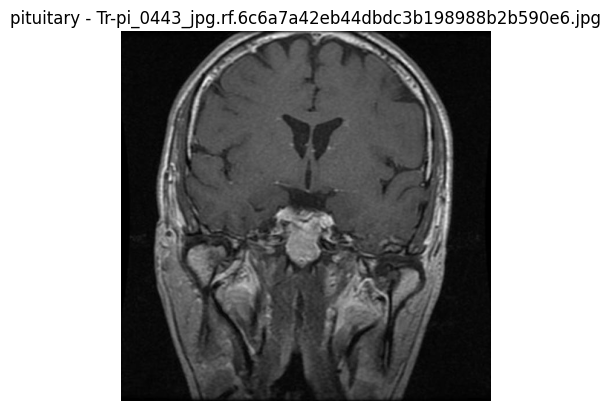

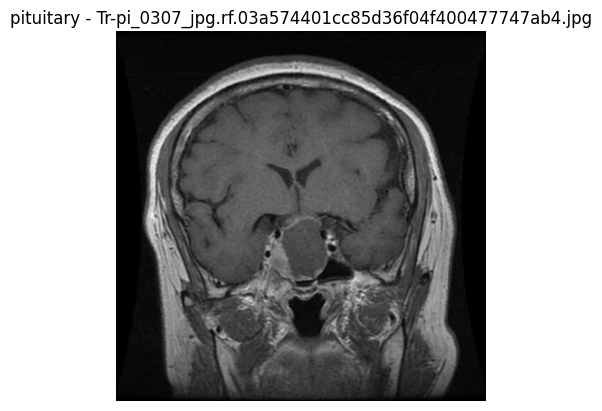

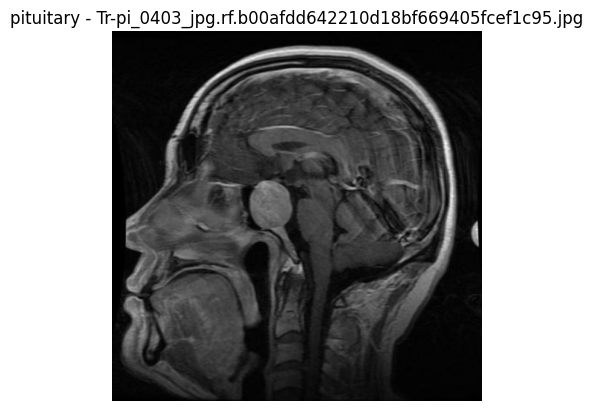

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

sample_image_path = os.path.join(train_dir, 'pituitary')
image_files = os.listdir(sample_image_path)

# Show 3 sample images
for i in range(3):
    img_path = os.path.join(sample_image_path, image_files[i])
    img = mpimg.imread(img_path)
    plt.imshow(img)
    plt.title(f"pituitary - {image_files[i]}")
    plt.axis('off')
    plt.show()

In [ ]:
#  Model Architecture: U-Net + Enhanced Classification Head
def build_model(img_size):
    inputs = Input(shape=(*img_size, 3))

    # Encoder
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    c1 = BatchNormalization()(c1)
    c1 = Dropout(0.1)(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    c2 = BatchNormalization()(c2)
    c2 = Dropout(0.2)(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(p2)
    c3 = BatchNormalization()(c3)
    c3 = Dropout(0.2)(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(256, (3, 3), activation='relu', padding='same')(p3)
    c4 = BatchNormalization()(c4)
    c4 = Dropout(0.3)(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(512, (3, 3), activation='relu', padding='same')(p4)
    c5 = BatchNormalization()(c5)
    c5 = Dropout(0.3)(c5)
    p5 = MaxPooling2D((2, 2))(c5)

    # Bottleneck
    b = Conv2D(1024, (3, 3), activation='relu', padding='same')(p5)
    b = BatchNormalization()(b)
    b = Dropout(0.4)(b)

    # Decoder
    u6 = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(b)
    u6 = concatenate([u6, c5])
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = BatchNormalization()(c6)
    c6 = Dropout(0.3)(c6)

    u7 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c4])
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = BatchNormalization()(c7)
    c7 = Dropout(0.3)(c7)

    u8 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c3])
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = BatchNormalization()(c8)
    c8 = Dropout(0.2)(c8)

    u9 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c2])
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = BatchNormalization()(c9)
    c9 = Dropout(0.2)(c9)

    u10 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c9)
    u10 = concatenate([u10, c1])
    c10 = Conv2D(32, (3, 3), activation='relu', padding='same')(u10)
    c10 = BatchNormalization()(c10)
    c10 = Dropout(0.1)(c10)

    # Segmentation output (likely extraneous for classification)
    # seg_output = Conv2D(1, (1, 1), activation='sigmoid', name='seg_output')(c5)

    # Enhanced Classification head
    clf = GlobalAveragePooling2D()(c3)
    clf = Dense(256, activation='relu')(clf)
    clf = Dropout(0.4)(clf)
    clf = Dense(128, activation='relu')(clf)
    clf = Dropout(0.3)(clf)
    clf_output = Dense(4, activation='softmax', name='clf_output')(clf)

    model = Model(inputs=[inputs], outputs=[clf_output])
    return model

In [ ]:
from tensorflow.keras.layers import (Input, Conv2D, MaxPooling2D,
                                     Conv2DTranspose, concatenate,
                                     UpSampling2D, Dropout, Dense, Flatten)


In [ ]:
# Build and Train the Model
model = build_model(IMG_SIZE)
model.compile(optimizer=Adam(learning_rate=0.001),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

history = model.fit(X_train, Y_train_encoded,
                    validation_data=(X_val, Y_val_encoded),
                    batch_size=16, epochs=30)

Epoch 1/30


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_268']
Received: inputs=Tensor(shape=(None, 128, 128, 3))
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_268']
Received: inputs=Tensor(shape=(None, 128, 128, 3))
  warnings.warn(msg)


106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.6189 - loss: 0.9433

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_268']
Received: inputs=Tensor(shape=(None, 128, 128, 3))
  warnings.warn(msg)


106/106 ━━━━━━━━━━━━━━━━━━━━ 140s 1s/step - accuracy: 0.6196 - loss: 0.9419 - val_accuracy: 0.2610 - val_loss: 2.4125
Epoch 2/30
106/106 ━━━━━━━━━━━━━━━━━━━━ 128s 1s/step - accuracy: 0.7608 - loss: 0.6499 - val_accuracy: 0.7530 - val_loss: 0.6355
Epoch 3/30
106/106 ━━━━━━━━━━━━━━━━━━━━ 132s 1s/step - accuracy: 0.7862 - loss: 0.5767 - val_accuracy: 0.5717 - val_loss: 2.3934
Epoch 4/30
106/106 ━━━━━━━━━━━━━━━━━━━━ 132s 1s/step - accuracy: 0.8207 - loss: 0.4940 - val_accuracy: 0.5378 - val_loss: 1.3211
Epoch 5/30
106/106 ━━━━━━━━━━━━━━━━━━━━ 135s 1s/step - accuracy: 0.8421 - loss: 0.4524 - val_accuracy: 0.4004 - val_loss: 1.9706
Epoch 6/30
106/106 ━━━━━━━━━━━━━━━━━━━━ 141s 1s/step - accuracy: 0.8637 - loss: 0.3862 - val_accuracy: 0.6135 - val_loss: 1.7663
Epoch 7/30
106/106 ━━━━━━━━━━━━━━━━━━━━ 143s 1s/step - accuracy: 0.8725 - loss: 0.3513 - val_accuracy: 0.5996 - val_loss: 2.6524
Epoch 8/30
106/106 ━━━━━━━━━━━━━━━━━━━━ 129s 1s/step - accuracy: 0.8745 - loss: 0.3480 - val_accuracy: 0.641

In [ ]:
#  Prediction on Test Images
preds = model.predict(X_test)


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_268']
Received: inputs=Tensor(shape=(32, 128, 128, 3))
  warnings.warn(msg)


7/8 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_268']
Received: inputs=Tensor(shape=(None, 128, 128, 3))
  warnings.warn(msg)


8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 349ms/step


In [ ]:
def display_results(image, pred_label, true_label=None, label_encoder=None):
    plt.figure(figsize=(4, 4))
    plt.imshow(image.astype('uint8'))
    title = ""

    if label_encoder:
        pred_class = label_encoder.inverse_transform([pred_label])[0]
        title = f"Predicted: {pred_class}"
        if true_label is not None:
            true_class = label_encoder.inverse_transform([true_label])[0]
            title += f"\nActual: {true_class}"
    else:
        title = f"Predicted Label: {pred_label}"
        if true_label is not None:
            title += f"\nActual Label: {true_label}"

    plt.title(title)
    plt.axis('off')
    plt.show()


In [ ]:
preds = model.predict(X_test)  # Predict on entire test set


8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 300ms/step


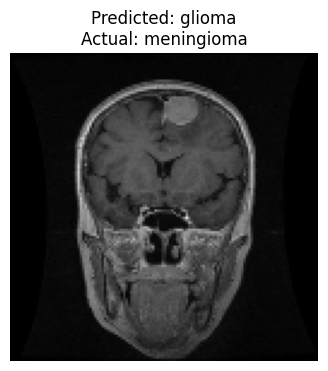

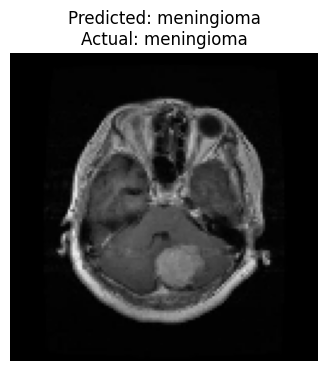

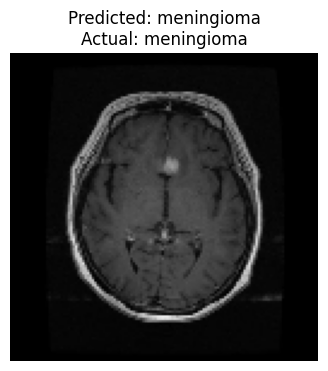

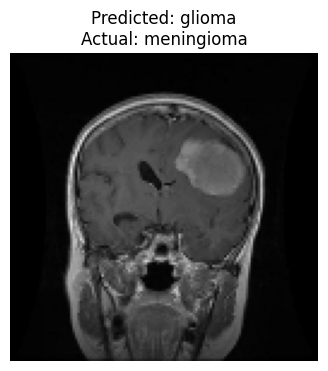

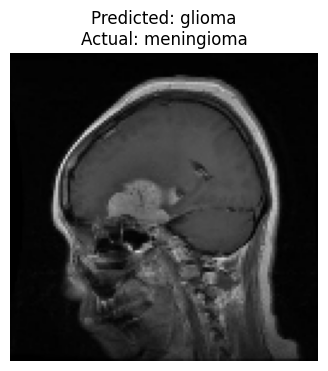

...

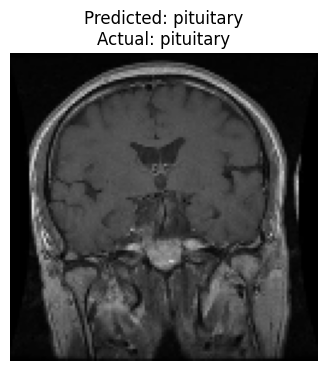

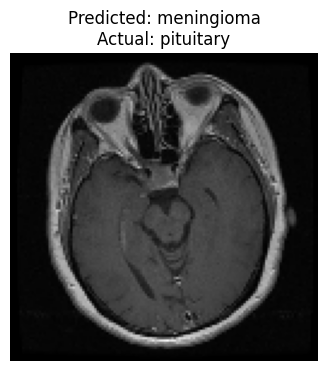

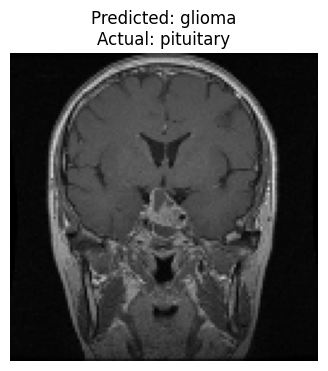

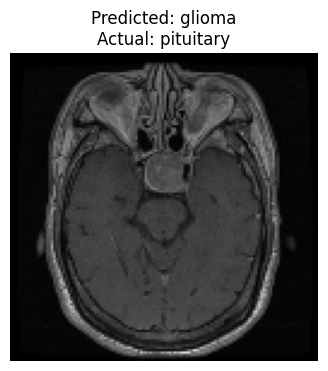

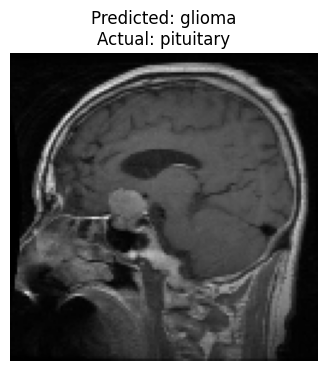

In [ ]:
for i in range(len(X_test)):  # Iterate over the number of test images
    predicted_label = np.argmax(preds[i])  # Get the predicted class for each image
    true_label = Y_test_encoded[i]
    display_results(X_test[i], predicted_label, true_label, label_encoder=le)

In [ ]:
predicted_classes = np.argmax(preds, axis=1)
misclassified_indices = np.where(predicted_classes != Y_test_encoded)[0]
print(f"Total misclassified: {len(misclassified_indices)}")

Total misclassified: 73


/tmp/ipython-input-77-2469225954.py:16: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-77-2469225954.py:16: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing f

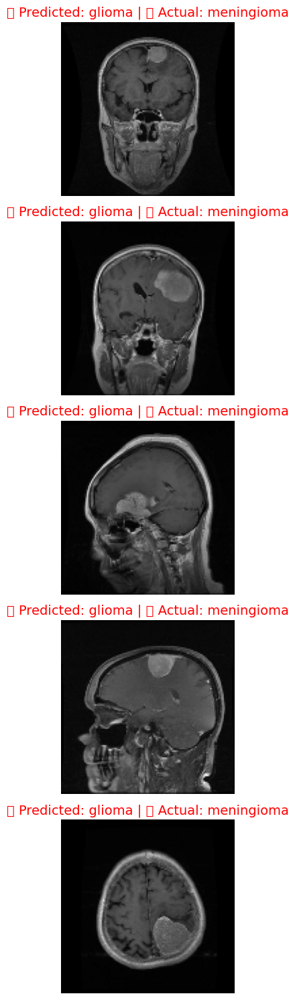

In [ ]:
import matplotlib.pyplot as plt

def show_misclassified(X, y_true, y_pred, indices, label_encoder, max_images=5):
    plt.figure(figsize=(15, 3 * max_images))

    for i, idx in enumerate(indices[:max_images]):
        img = X[idx].astype('uint8')
        true_label = label_encoder.inverse_transform([y_true[idx]])[0]
        pred_label = label_encoder.inverse_transform([y_pred[idx]])[0]

        plt.subplot(max_images, 1, i+1)
        plt.imshow(img)
        plt.title(f"❌ Predicted: {pred_label} | ✅ Actual: {true_label}", fontsize=14, color='red')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Call the function
show_misclassified(X_test, Y_test_encoded, predicted_classes, misclassified_indices, le, max_images=5)


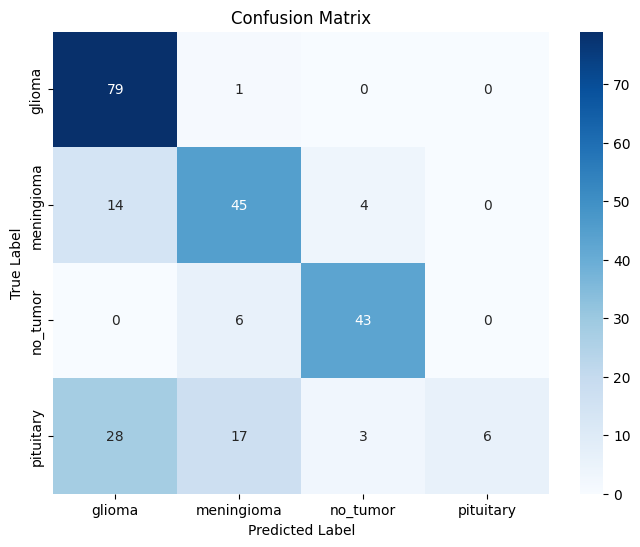

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
# Ground truth and predicted labels (integer-encoded)
y_true = Y_test_encoded
y_pred = np.argmax(preds, axis=1)
# Class labels (string form)
class_names = le.classes_
# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot using seaborn heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)

plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

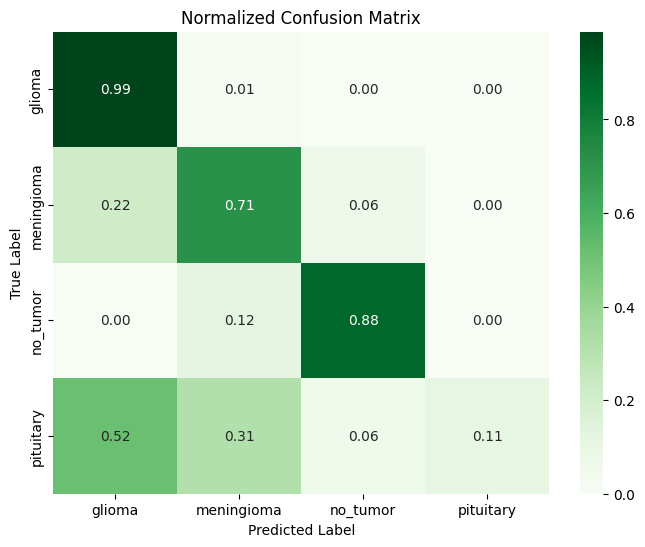

In [ ]:
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

plt.figure(figsize=(8, 6))
sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Greens',
            xticklabels=class_names, yticklabels=class_names)

plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Normalized Confusion Matrix')
plt.show()


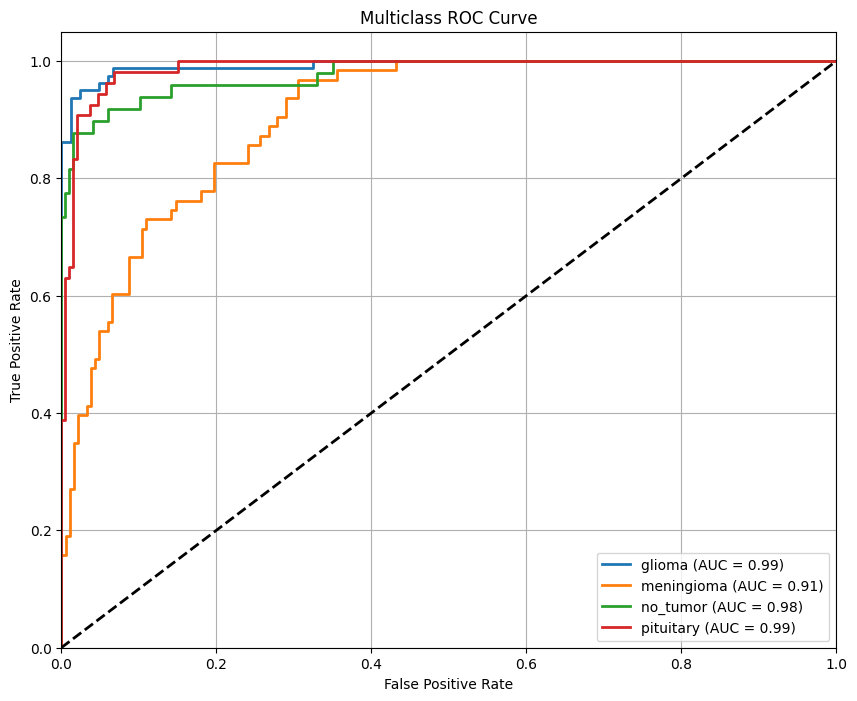

In [ ]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt
import numpy as np
# True labels (encoded) and predicted probabilities
y_true = Y_test_encoded  # shape (n_samples,)
y_score = preds       # shape (n_samples, n_classes)
# Get class names and number of classes
class_names = le.classes_
n_classes = len(class_names)
# Binarize the output (one-hot encoded ground truth)
y_true_bin = label_binarize(y_true, classes=np.arange(n_classes))
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2,
             label=f'{class_names[i]} (AUC = {roc_auc[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multiclass ROC Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

In [ ]:
final_train_acc = history.history['accuracy'][-1]
final_val_acc = history.history['val_accuracy'][-1]
print(f" Final Training Accuracy: {final_train_acc:.4f}")
print(f" Final Validation Accuracy: {final_val_acc:.4f}")


 Final Training Accuracy: 0.9670
 Final Validation Accuracy: 0.6873


In [ ]:
import keras
keras.utils.generic_utils = keras.utils


In [ ]:
pip install segmentation-models


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 3.3 MB/s eta 0:00:00


In [ ]:
import segmentation_models as sm


Segmentation Models: using `keras` framework.


In [ ]:
import segmentation_models as sm
from tensorflow.keras.optimizers import Adam

# Set framework and parameters
sm.set_framework('tf.keras')
sm.framework()

# Build U-Net with ResNet50 encoder
model = sm.Unet('resnet50',
                input_shape=(128, 128, 3),
                classes=1,
                activation='sigmoid',
                encoder_weights='imagenet')

# Compile
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=sm.losses.bce_dice_loss,
              metrics=[sm.metrics.iou_score, 'accuracy'])


94592056/94592056 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


In [ ]:
pip install albumentations


In [ ]:
import albumentations as A
from albumentations.core.composition import OneOf
from tensorflow.keras.utils import Sequence
import cv2
import numpy as np

# Example augmentation pipeline
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.5),
    A.ElasticTransform(alpha=1, sigma=50, alpha_affine=50, p=0.2)
])


/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
/tmp/ipython-input-24-1436023620.py:12: UserWarning: Argument(s) 'alpha_affine' are not valid for transform ElasticTransform
  A.ElasticTransform(alpha=1, sigma=50, alpha_affine=50, p=0.2)


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

callbacks = [
    EarlyStopping(patience=10, monitor='val_loss', restore_best_weights=True),
    ReduceLROnPlateau(patience=5, factor=0.5, monitor='val_loss'),
    ModelCheckpoint("best_model.h5", save_best_only=True, monitor='val_loss')
]


In [ ]:
Y_train_encoded = Y_train_encoded[..., np.newaxis]
Y_val_encoded = Y_val_encoded[..., np.newaxis]


In [ ]:
Y_test_encoded = Y_test_encoded[..., np.newaxis]


In [ ]:
print(Y_train_encoded.shape)
print(np.unique(Y_train_encoded))


(1695, 1)
[0 1 2 3]


In [ ]:
import matplotlib.pyplot as plt

def visualize_prediction(image, ground_truth, prediction):
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title("Image")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(ground_truth.squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow((prediction.squeeze() > 0.5).astype(np.uint8), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.show()


In [ ]:
def dice_loss(y_true, y_pred, smooth=1):
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return 1 - (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)


In [ ]:
import os
import cv2
import numpy as np

def load_data(data_dir, img_size=(128, 128)):
    X = []
    Y = []
    class_names = os.listdir(data_dir)
    class_names.sort()  # to keep label consistency

    for label, class_name in enumerate(class_names):
        class_path = os.path.join(data_dir, class_name)
        if not os.path.isdir(class_path):
            continue
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)
            try:
                img = cv2.imread(img_path)
                img = cv2.resize(img, img_size)
                img = img / 255.0  # Normalize
                X.append(img)
                Y.append(label)
            except:
                continue

    return np.array(X), np.array(Y)


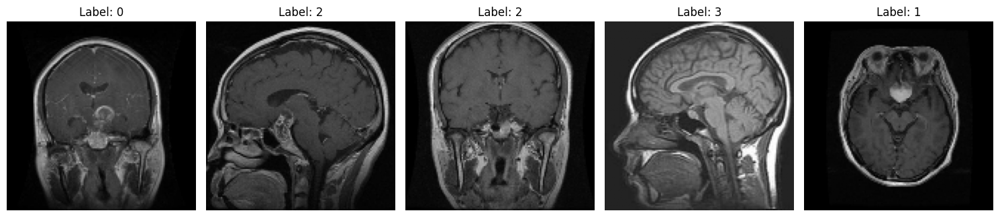

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import random

# Display 5 random test images
num_images = 5
random_indices = random.sample(range(len(X_test)), num_images)

plt.figure(figsize=(15, 5))
for i, idx in enumerate(random_indices):
    image = X_test[idx]
    label = labels_test[idx]

    plt.subplot(1, num_images, i + 1)
    plt.imshow(image)
    plt.title(f"Label: {label}")
    plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
print(type(X_test))
print(type(X_test[0]))
print(X_test[0])


<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[[[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 ...

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]

 [[0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]
  ...
  [0. 0. 0.]
  [0. 0. 0.]
  [0. 0. 0.]]]


In [ ]:
from sklearn.metrics import roc_auc_score

# Predict class probabilities
preds = model.predict(X_test)

# Flatten both predictions and true values
y_true = Y_test.ravel()
y_pred = preds.ravel()

# Compute AUC
auc = roc_auc_score(y_true, y_pred, average='macro', multi_class='ovr')
print("AUC Score:", auc)


8/8 ━━━━━━━━━━━━━━━━━━━━ 47s 4s/step
AUC Score: 0.3362706661419866


In [ ]:
pip install streamlit

In [ ]:
import os

# Search recursively for all .h5 files
for root, dirs, files in os.walk("/"):
    for file in files:
        if file.endswith(".h5"):
            print(os.path.join(root, file))


/root/.julia/packages/FileIO/ePyCW/test/files/file2.h5
/root/.julia/packages/FileIO/ePyCW/test/files/file1.h5
/root/.julia/packages/FileIO/ePyCW/test/files/h5ad.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/attr-u16.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/flavored_vlarrays-format1.6.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/smpl_i32be.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/array_mdatom.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/ex-noattr.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/smpl_i64be.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/zerodim-attrs-1.4.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/Tables_lzo2.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/elink.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/Tables_lzo1_shuffle.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/issue_368.h5
/usr/local/lib/python3.11/dist-packages/tables/tests/smpl_SDSextendible.

In [ ]:
from tensorflow.keras.layers import (Input, Conv2D, MaxPooling2D,
                                     Conv2DTranspose, concatenate,
                                     UpSampling2D, Dropout, Dense, Flatten, BatchNormalization, GlobalAveragePooling2D)
from tensorflow.keras.models import Model

#  Model Architecture: U-Net + Enhanced Classification Head
def build_model(img_size):
    inputs = Input(shape=(*img_size, 3))

    # Encoder
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    c1 = BatchNormalization()(c1)
    c1 = Dropout(0.1)(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    c2 = BatchNormalization()(c2)
    c2 = Dropout(0.2)(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(p2)
    c3 = BatchNormalization()(c3)
    c3 = Dropout(0.2)(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(256, (3, 3), activation='relu', padding='same')(p3)
    c4 = BatchNormalization()(c4)
    c4 = Dropout(0.3)(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(512, (3, 3), activation='relu', padding='same')(p4)
    c5 = BatchNormalization()(c5)
    c5 = Dropout(0.3)(c5)
    p5 = MaxPooling2D((2, 2))(c5)

    # Bottleneck
    b = Conv2D(1024, (3, 3), activation='relu', padding='same')(p5)
    b = BatchNormalization()(b)
    b = Dropout(0.4)(b)

    # Decoder
    u6 = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(b)
    u6 = concatenate([u6, c5])
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = BatchNormalization()(c6)
    c6 = Dropout(0.3)(c6)

    u7 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c4])
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = BatchNormalization()(c7)
    c7 = Dropout(0.3)(c7)

    u8 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c3])
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = BatchNormalization()(c8)
    c8 = Dropout(0.2)(c8)

    u9 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c2])
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = BatchNormalization()(c9)
    c9 = Dropout(0.2)(c9)

    u10 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c9)
    u10 = concatenate([u10, c1])
    c10 = Conv2D(32, (3, 3), activation='relu', padding='same')(u10)
    c10 = BatchNormalization()(c10)
    c10 = Dropout(0.1)(c10)

    # Segmentation output (likely extraneous for classification)
    # seg_output = Conv2D(1, (1, 1), activation='sigmoid', name='seg_output')(c5)

    # Enhanced Classification head
    clf = GlobalAveragePooling2D()(c3)
    clf = Dense(256, activation='relu')(clf)
    clf = Dropout(0.4)(clf)
    clf = Dense(128, activation='relu')(clf)
    clf = Dropout(0.3)(clf)
    clf_output = Dense(4, activation='softmax', name='clf_output')(clf)

    model = Model(inputs=[inputs], outputs=[clf_output])
    return model

In [ ]:
#  Dataset Paths
train_dir = '/content/tumor_data/Tumour/train'
val_dir = '/content/tumor_data/Tumour/valid'
test_dir = '/content/tumor_data/Tumour/test'
IMG_SIZE = (128, 128)

In [ ]:
model.save('cnn_brain_tumor_model.keras')


In [ ]:
import streamlit as st
from tensorflow.keras.models import load_model
import numpy as np
from PIL import Image

# Load the trained model
model = load_model('cnn_brain_tumor_model.keras')  # or .h5

# Define class labels
class_names = ['glioma', 'meningioma', 'pituitary', 'no_tumor']

st.title("Brain Tumor MRI Image Classification")
uploaded_file = st.file_uploader("Upload an MRI Image", type=["jpg", "png", "jpeg"])

if uploaded_file:
    image = Image.open(uploaded_file).resize((128, 128))
    st.image(image, caption="Uploaded MRI", use_column_width=True)

    # Preprocess image
    img_array = np.expand_dims(np.array(image) / 255.0, axis=0)

    # Predict
    prediction = model.predict(img_array)
    predicted_class = class_names[np.argmax(prediction)]

    st.success(f"Prediction: **{predicted_class}**")
    st.info(f"Confidence: {np.max(prediction) * 100:.2f}%")


2025-07-18 17:24:27.803 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-07-18 17:24:27.812 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-07-18 17:24:27.814 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-07-18 17:24:27.819 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-07-18 17:24:27.820 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-07-18 17:24:27.821 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-07-18 17:24:27.822 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-07-18 17:24:27.823 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bar